<a href="https://colab.research.google.com/github/atropass/computer_vision/blob/main/object_detection.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
from google.colab import drive
drive.mount('/content/drive')


Mounted at /content/drive


In [2]:
import os
from PIL import Image
import matplotlib.pyplot as plt

In [3]:
def display_images(folder_path, num_images=5):
    images = os.listdir(folder_path)[:num_images]
    plt.figure(figsize=(15, 10))
    for i, image_name in enumerate(images):
        img_path = os.path.join(folder_path, image_name)
        img = Image.open(img_path)
        plt.subplot(1, num_images, i + 1)
        plt.imshow(img)
        plt.title(image_name)
        plt.axis('off')
    plt.show()

In [4]:
calculator_images_path = '/content/drive/My Drive/Colab Notebooks/EPAM OD/Calculator'
chocolate_images_path = '/content/drive/My Drive/Colab Notebooks/EPAM OD/Chocolate'

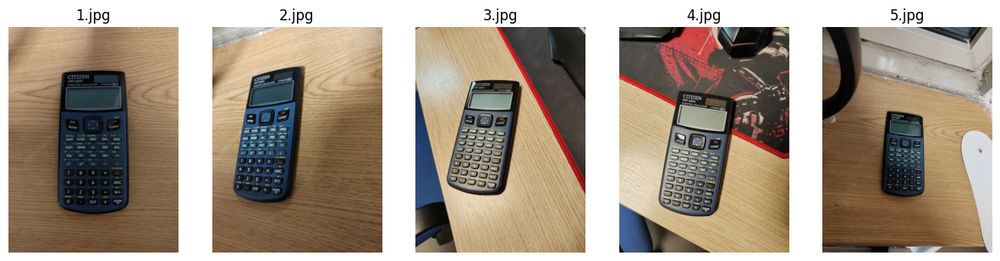

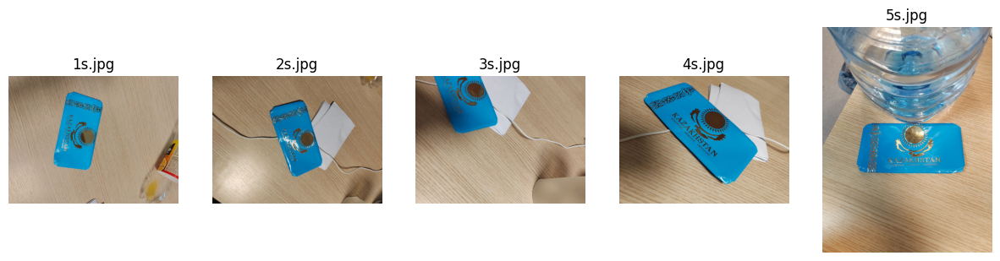

In [ ]:
display_images(calculator_images_path)
display_images(chocolate_images_path)

In [5]:
import json
from pycocotools.coco import COCO
import matplotlib.patches as patches

In [ ]:
annotations_path = '/content/drive/My Drive/EPAM OD/instances_default.json'
coco = COCO(annotations_path)

loading annotations into memory...
Done (t=0.33s)
creating index...
index created!


In [6]:
def display_labeled_images(image_dir, coco, category_name, num_images=5):
    category_ids = coco.getCatIds(catNms=[category_name])
    image_ids = coco.getImgIds(catIds=category_ids)
    images = coco.loadImgs(image_ids[:num_images])

    for i, img_info in enumerate(images):
        image_path = os.path.join(image_dir, img_info['file_name'])
        image = Image.open(image_path)

        plt.figure(figsize=(8, 6))
        plt.imshow(image)
        plt.axis('off')

        ann_ids = coco.getAnnIds(imgIds=img_info['id'], catIds=category_ids, iscrowd=None)
        anns = coco.loadAnns(ann_ids)

        for ann in anns:
            bbox = ann['bbox']
            rect = patches.Rectangle((bbox[0], bbox[1]), bbox[2], bbox[3], linewidth=2, edgecolor='r', facecolor='none')
            plt.gca().add_patch(rect)

        plt.show()

In [ ]:
calculator_image_dir = '/content/drive/My Drive/EPAM OD/Calculator'
chocolate_image_dir = '/content/drive/My Drive/EPAM OD/Chocolate'
display_labeled_images(calculator_image_dir, coco, 'calculator')
display_labeled_images(chocolate_image_dir, coco, 'chocolate')


In [ ]:
target_size = (512, 512)

In [ ]:
with open('/content/drive/My Drive/EPAM OD/instances_default.json') as json_file:
    data = json.load(json_file)

In [ ]:
updated_annotations = {'images': [], 'annotations': [], 'categories': data['categories']}

In [ ]:
def update_image_annotations(folder_name):
    for img_info in data['images']:
        image_path = os.path.join('/content/drive/My Drive/EPAM OD', folder_name, img_info['file_name'])
        if os.path.exists(image_path):
            with Image.open(image_path) as img:
                original_size = img.size

                img = img.resize(target_size, Image.ANTIALIAS)
                img.save(image_path)
                img_info['width'], img_info['height'] = target_size
                updated_annotations['images'].append(img_info)
            for ann in data['annotations']:
                if ann['image_id'] == img_info['id']:
                    x_scale = target_size[0] / original_size[0]
                    y_scale = target_size[1] / original_size[1]
                    bbox = ann['bbox']
                    bbox[0] = round(bbox[0] * x_scale)
                    bbox[1] = round(bbox[1] * y_scale)
                    bbox[2] = round(bbox[2] * x_scale)
                    bbox[3] = round(bbox[3] * y_scale)
                    ann['bbox'] = bbox

                    updated_annotations['annotations'].append(ann)

In [ ]:
update_image_annotations('Calculator')
update_image_annotations('Chocolate')

<ipython-input-13-a2256072fdd7>:11: DeprecationWarning: ANTIALIAS is deprecated and will be removed in Pillow 10 (2023-07-01). Use LANCZOS or Resampling.LANCZOS instead.
  img = img.resize(target_size, Image.ANTIALIAS)


In [ ]:
with open('/content/drive/My Drive/EPAM OD/updated_instances_default.json', 'w') as outfile:
    json.dump(updated_annotations, outfile)

In [10]:
annotations_path = '/content/drive/My Drive/Colab Notebooks/EPAM OD/updated_instances_default.json'
coco = COCO(annotations_path)

loading annotations into memory...
Done (t=1.32s)
creating index...
index created!


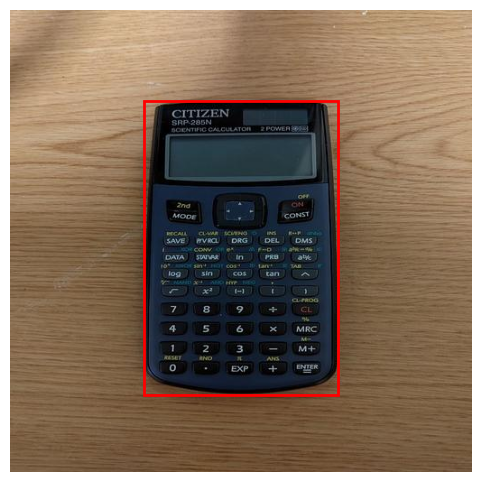

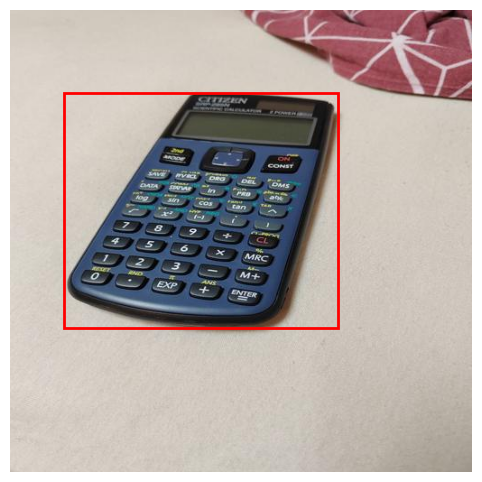

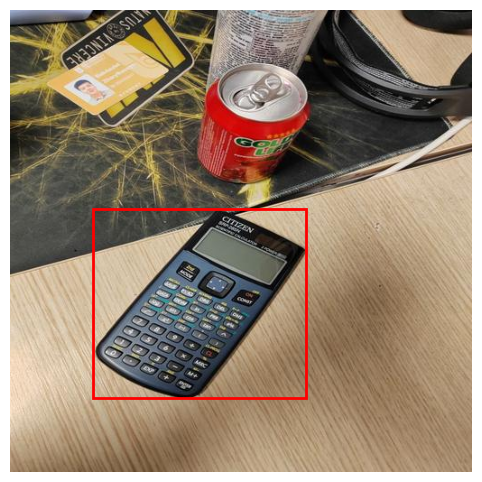

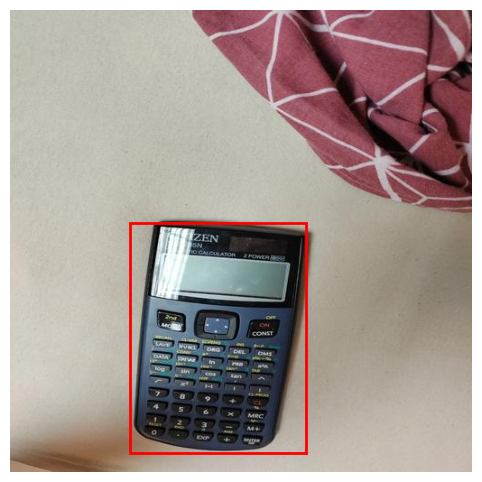

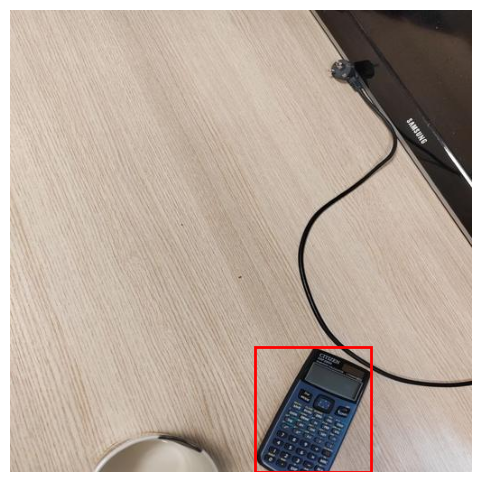

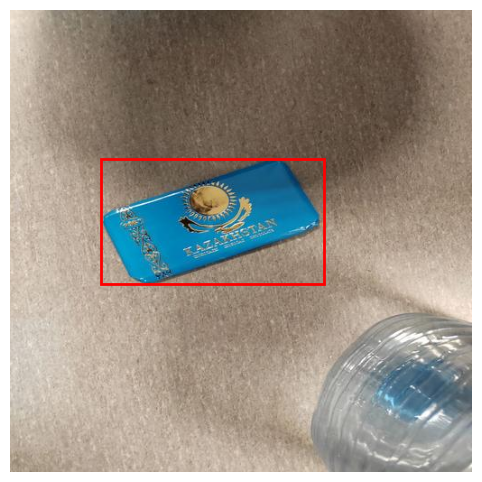

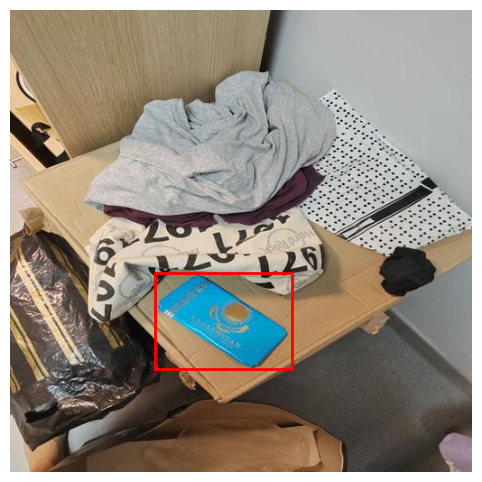

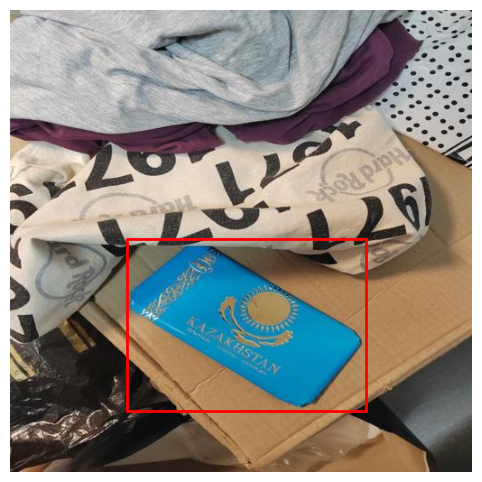

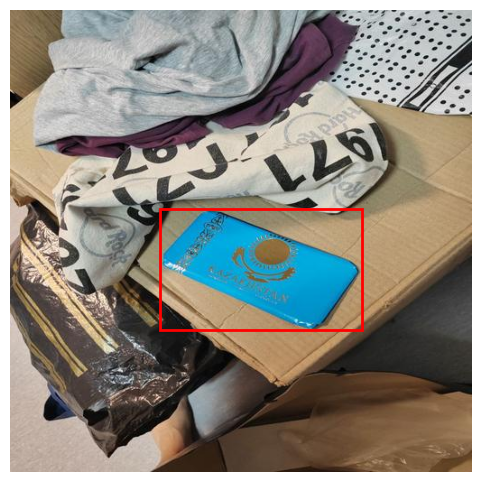

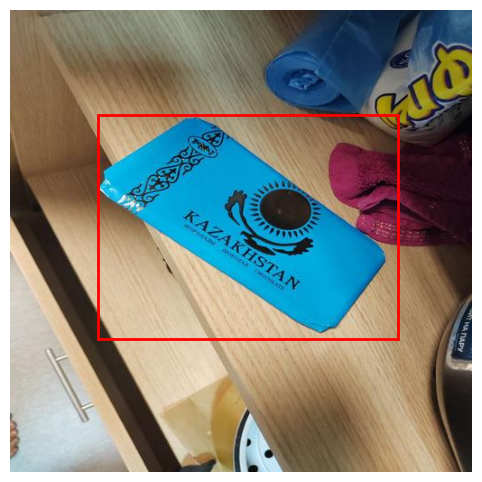

In [11]:
calculator_image_dir = '/content/drive/My Drive/Colab Notebooks/EPAM OD/Calculator'
chocolate_image_dir = '/content/drive/My Drive/Colab Notebooks/EPAM OD/Chocolate'
display_labeled_images(calculator_image_dir, coco, 'calculator')
display_labeled_images(chocolate_image_dir, coco, 'chocolate')


In [ ]:
def display_labeled_images(image_dir, category_name, coco, num_images=5):
    category_ids = coco.getCatIds(catNms=[category_name])
    image_ids = coco.getImgIds(catIds=category_ids)
    images = coco.loadImgs(image_ids[:num_images])

    for i, img_info in enumerate(images):
        image_path = os.path.join(image_dir, img_info['file_name'])
        image = Image.open(image_path)

        plt.figure(figsize=(10, 10))
        plt.imshow(image)
        plt.axis('off')
        plt.title(f"{category_name}: {img_info['file_name']}")

        ann_ids = coco.getAnnIds(imgIds=img_info['id'], catIds=category_ids, iscrowd=None)
        anns = coco.loadAnns(ann_ids)

        for ann in anns:
            bbox = ann['bbox']
            label = coco.loadCats(ann['category_id'])[0]['name']
            rect = patches.Rectangle((bbox[0], bbox[1]), bbox[2], bbox[3], linewidth=2, edgecolor='r', facecolor='none')
            plt.gca().add_patch(rect)
            plt.text(bbox[0], bbox[1], f'{label}', color='white', fontsize=12, bbox=dict(facecolor='red', alpha=0.5))

        plt.show()

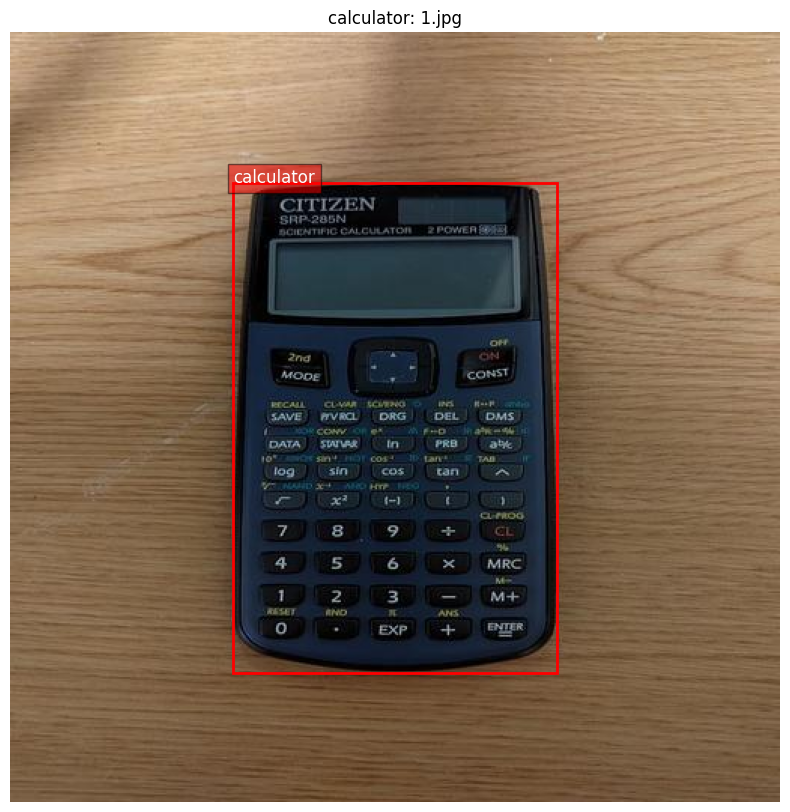

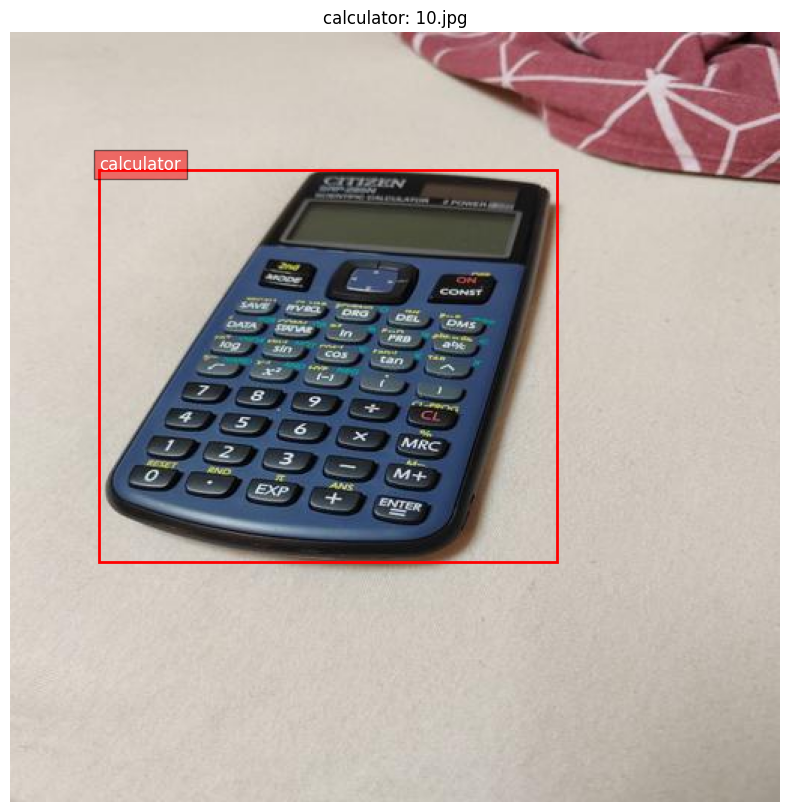

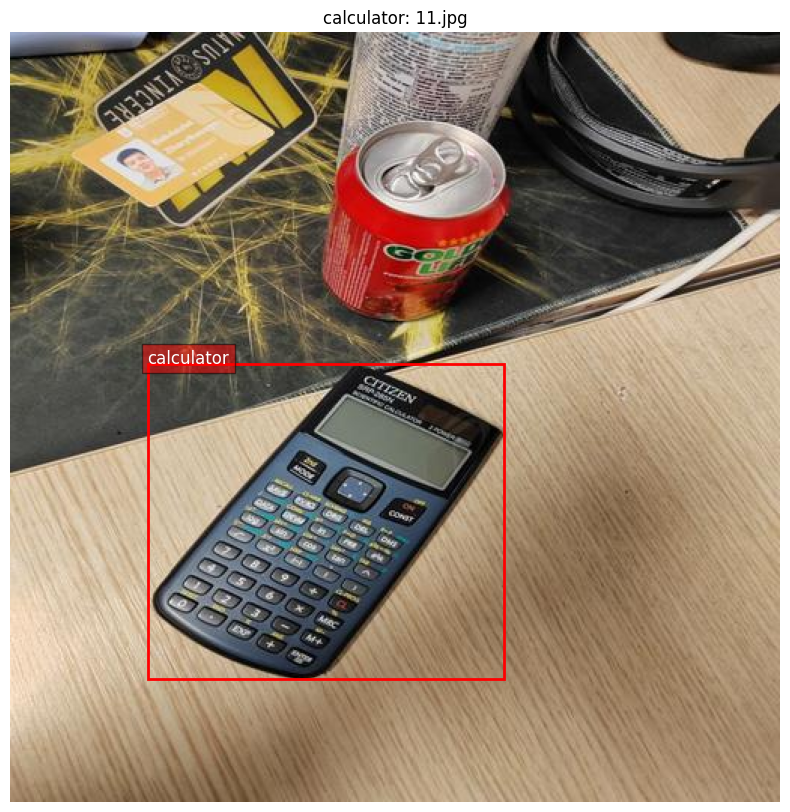

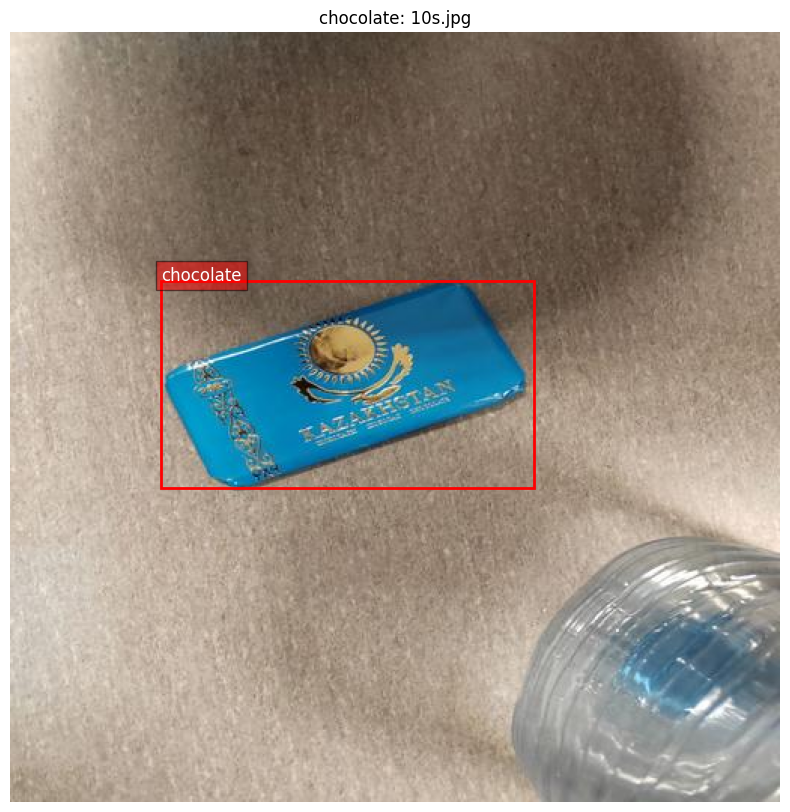

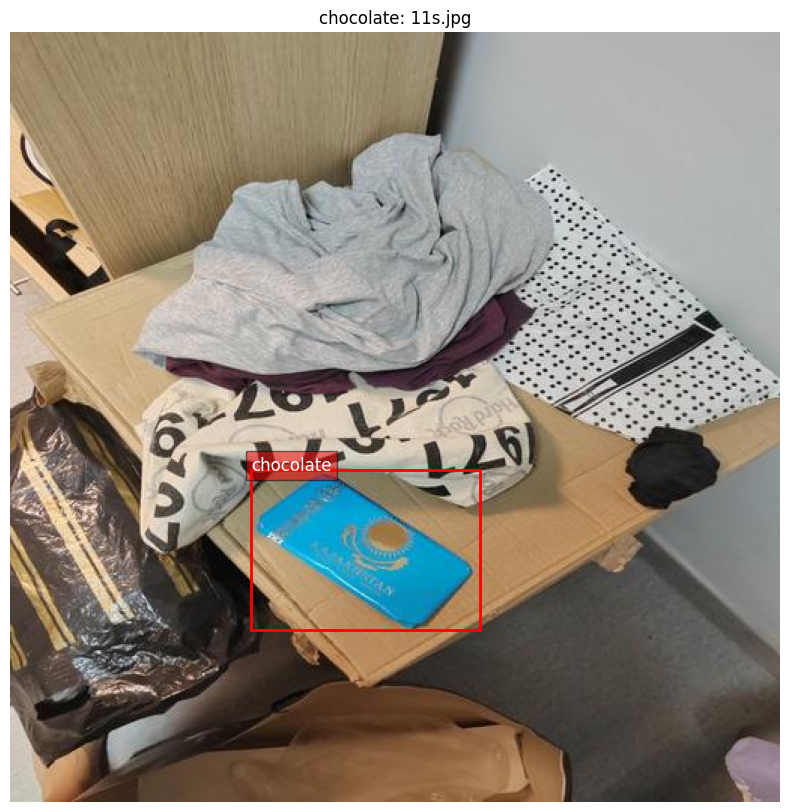

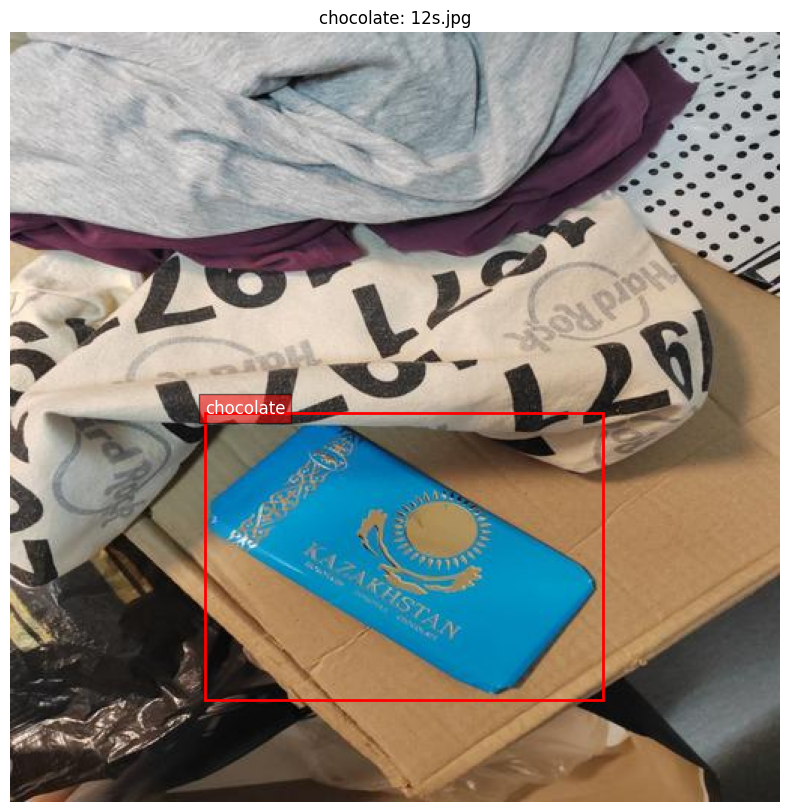

In [ ]:
display_labeled_images(calculator_image_dir, 'calculator', coco, num_images=3)
display_labeled_images(chocolate_image_dir, 'chocolate', coco, num_images=3)

In [ ]:
!pip install torch torchvision

In [ ]:
!pip install albumentations

In [ ]:
import matplotlib.pyplot as plt
import matplotlib.patches as patches

In [ ]:
import torch
import torchvision
from torchvision.models.detection import fasterrcnn_resnet50_fpn
from albumentations.pytorch import ToTensorV2
import albumentations as A

In [ ]:
import numpy as np

In [ ]:
def get_augmentation():
    return A.Compose([
        A.HorizontalFlip(p=0.5),
        A.RandomBrightnessContrast(p=0.2),
        A.HueSaturationValue(hue_shift_limit=20, sat_shift_limit=30, val_shift_limit=20, p=0.5)
    ], bbox_params=A.BboxParams(format='coco', label_fields=['category_ids']))

In [ ]:
def apply_augmentations(image_dir, coco, category_name, num_images=5):
    augmentation = get_augmentation()
    category_ids = coco.getCatIds(catNms=[category_name])
    image_ids = coco.getImgIds(catIds=category_ids)
    images = coco.loadImgs(image_ids[:num_images])
    augmented_images = []

    for img_info in images:
        image_path = os.path.join(image_dir, img_info['file_name'])
        image = Image.open(image_path)
        image = np.array(image)
        ann_ids = coco.getAnnIds(imgIds=img_info['id'], catIds=category_ids, iscrowd=None)
        anns = coco.loadAnns(ann_ids)
        bboxes = [ann['bbox'] for ann in anns]
        category_ids = [ann['category_id'] for ann in anns]

        transformed = augmentation(image=image, bboxes=bboxes, category_ids=category_ids)
        augmented_images.append((img_info, transformed['image'], transformed['bboxes'], transformed['category_ids']))

    return augmented_images

In [ ]:
def display_transformed_images(augmented_images):
    for img_info, image, bboxes, _ in augmented_images:
        plt.figure(figsize=(8, 6))
        plt.imshow(image)
        plt.axis('off')
        for bbox in bboxes:
            rect = patches.Rectangle((bbox[0], bbox[1]), bbox[2], bbox[3], linewidth=2, edgecolor='r', facecolor='none')
            plt.gca().add_patch(rect)
        plt.show()

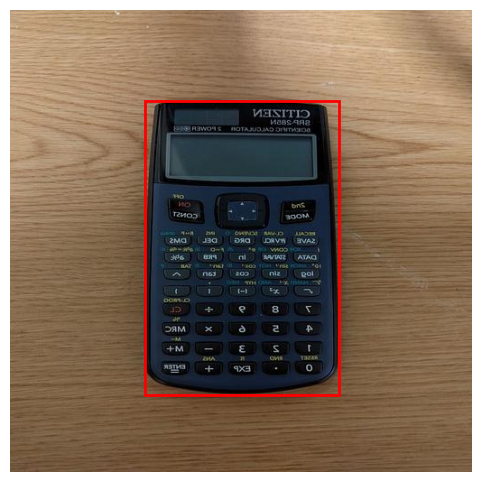

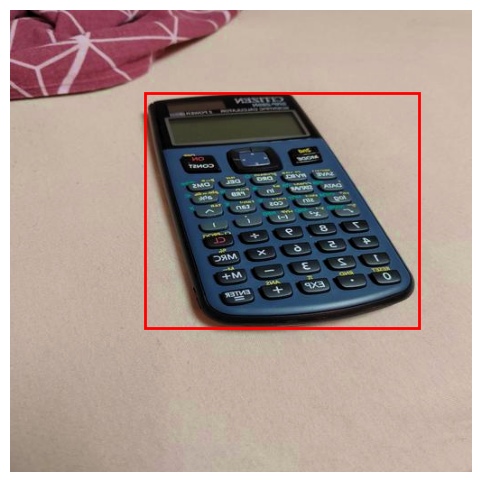

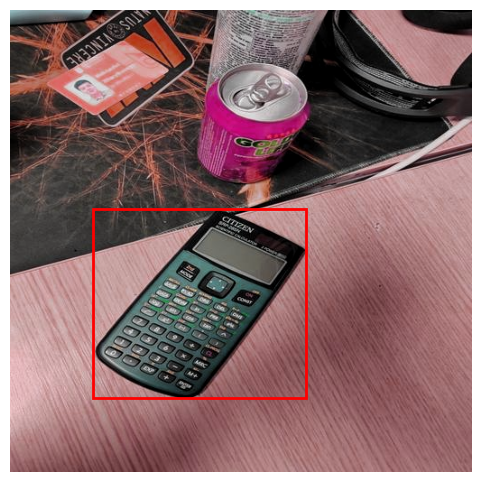

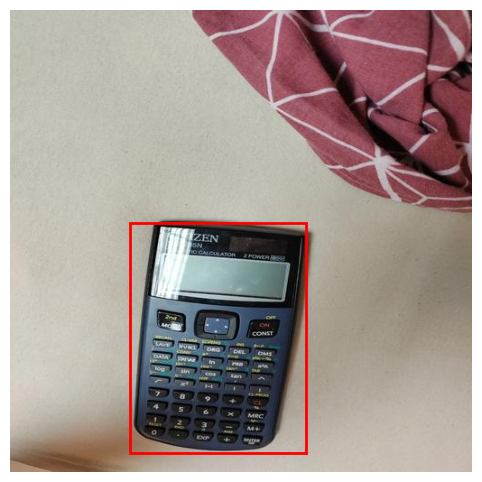

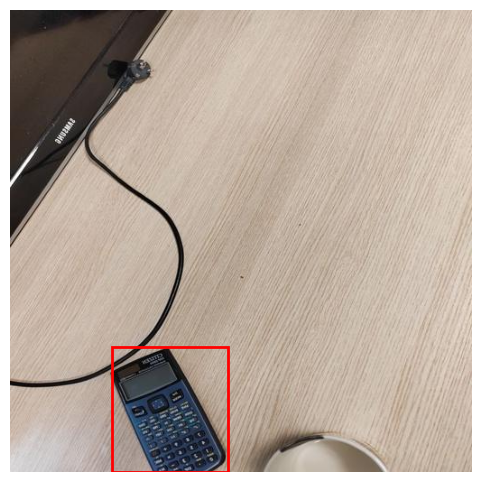

In [ ]:
augmented_calculators = apply_augmentations(calculator_image_dir, coco, 'calculator', num_images=5)
display_transformed_images(augmented_calculators)

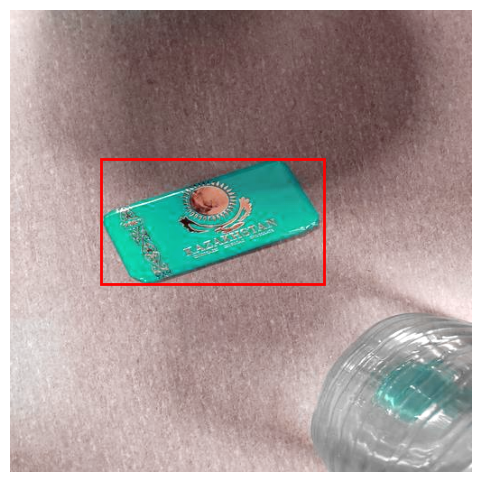

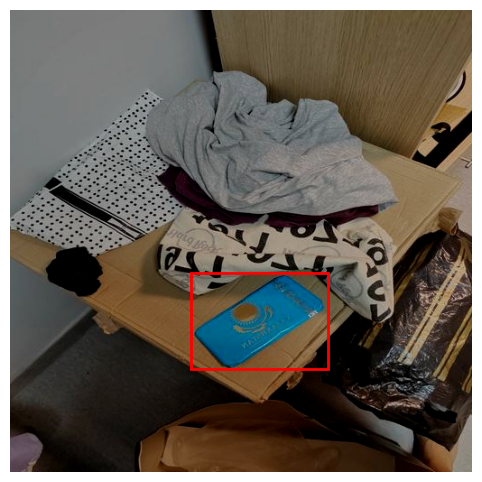

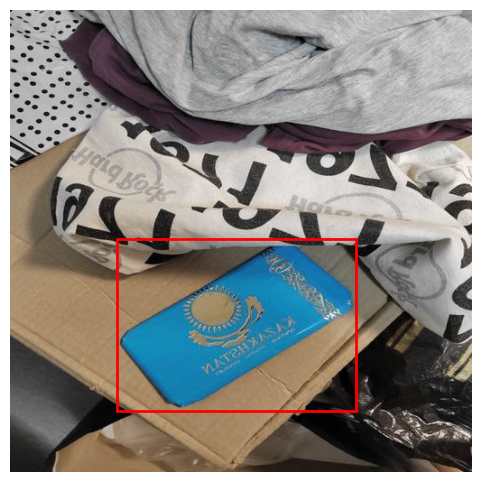

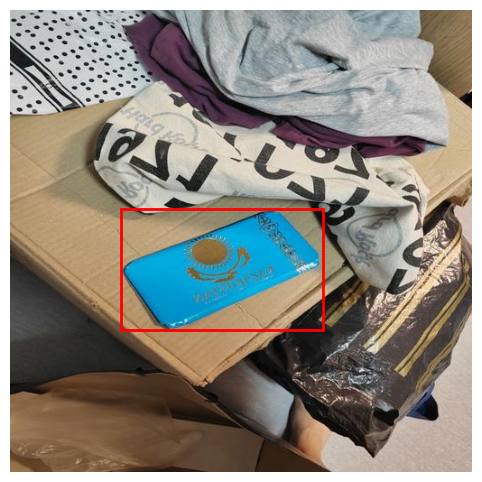

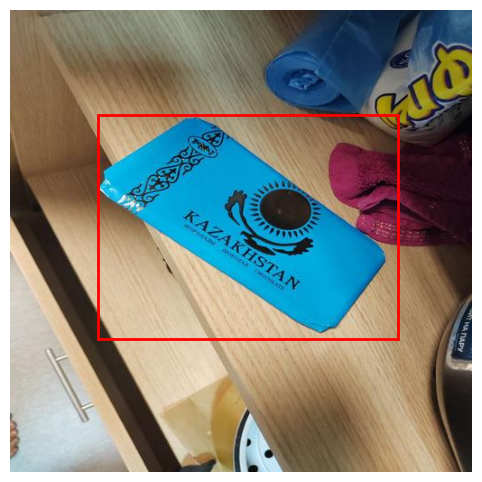

In [ ]:
augmented_chocolates = apply_augmentations(chocolate_image_dir, coco, 'chocolate', num_images=5)
display_transformed_images(augmented_chocolates)

In [12]:
import torch
import torchvision
from torchvision.models.detection import FasterRCNN
from torchvision.models.detection.rpn import AnchorGenerator
from torchvision.transforms import functional as F

In [13]:
def split_dataset(image_dir, category, coco, num_test=10):
    category_ids = coco.getCatIds(catNms=[category])
    image_ids = coco.getImgIds(catIds=category_ids)
    np.random.shuffle(image_ids)
    train_ids = image_ids[num_test:]
    test_ids = image_ids[:num_test]
    return train_ids, test_ids

In [17]:
import numpy as np

In [18]:
train_ids_calculator, test_ids_calculator = split_dataset(calculator_image_dir, 'calculator', coco)
train_ids_chocolate, test_ids_chocolate = split_dataset(chocolate_image_dir, 'chocolate', coco)

In [45]:
class DetectionDataset(torch.utils.data.Dataset):
    def __init__(self, image_dir, ids, coco, is_chocolate=False, transforms=None):
        self.image_dir = image_dir
        self.ids = ids
        self.coco = coco
        self.is_chocolate = is_chocolate
        self.transforms = transforms

    def __getitem__(self, index):
        img_id = self.ids[index]
        img_info = self.coco.loadImgs(img_id)[0]
        if self.is_chocolate:
            path = os.path.join(self.image_dir, str(img_info['file_name'].split('.')[0]) + '.jpg')
        else:
            path = os.path.join(self.image_dir, img_info['file_name'])
        image = Image.open(path).convert("RGB")

        ann_ids = self.coco.getAnnIds(imgIds=img_id)
        anns = self.coco.loadAnns(ann_ids)
        boxes = [ann['bbox'] for ann in anns]
        boxes = torch.as_tensor(boxes, dtype=torch.float32).reshape(-1, 4)
        boxes[:, 2:] += boxes[:, :2]

        labels = torch.tensor([ann['category_id'] for ann in anns], dtype=torch.int64)
        target = {'boxes': boxes, 'labels': labels}

        if self.transforms:
            image, target = self.transforms(image, target)

        return F.to_tensor(image), target

    def __len__(self):
        return len(self.ids)


In [46]:
def simple_transform(img, target):
    img = F.resize(img, (512, 512))
    target['boxes'] = target['boxes'] * torch.tensor([512 / img.width, 512 / img.height, 512 / img.width, 512 / img.height])
    return img, target

In [47]:
train_dataset_calculator = DetectionDataset(calculator_image_dir, train_ids_calculator, coco, transforms=simple_transform)
test_dataset_calculator = DetectionDataset(calculator_image_dir, test_ids_calculator, coco, transforms=simple_transform)


In [48]:
train_dataset_chocolate = DetectionDataset(chocolate_image_dir, train_ids_chocolate, coco, is_chocolate=True, transforms=simple_transform)
test_dataset_chocolate = DetectionDataset(chocolate_image_dir, test_ids_chocolate, coco, is_chocolate=True, transforms=simple_transform)

In [49]:
from torch.utils.data import Dataset, DataLoader

In [50]:
train_loader_calculator = DataLoader(train_dataset_calculator, batch_size=2, shuffle=True, collate_fn=lambda x: tuple(zip(*x)))
test_loader_calculator = DataLoader(test_dataset_calculator, batch_size=2, shuffle=False, collate_fn=lambda x: tuple(zip(*x)))

In [51]:
train_loader_chocolate = DataLoader(train_dataset_chocolate, batch_size=2, shuffle=True, collate_fn=lambda x: tuple(zip(*x)))
test_loader_chocolate = DataLoader(test_dataset_chocolate, batch_size=2, shuffle=False, collate_fn=lambda x: tuple(zip(*x)))

In [ ]:
device = torch.device('cuda') if torch.cuda.is_available() else torch.device('cpu')
model = torchvision.models.detection.fasterrcnn_resnet50_fpn(pretrained=True)
model.to(device)

In [53]:
import torch
import matplotlib.pyplot as plt
from sklearn.metrics import confusion_matrix
import seaborn as sns
from sklearn.metrics import classification_report
from sklearn.metrics import precision_recall_fscore_support

In [54]:
for param in model.parameters():
    param.requires_grad = False
for param in model.roi_heads.parameters():
    param.requires_grad = True

In [55]:
optimizer = torch.optim.Adam(filter(lambda p: p.requires_grad, model.parameters()), lr=0.005)

In [56]:
losses_per_epoch = []

In [57]:
model.train()
num_epochs = 10
for epoch in range(num_epochs):
    total_loss = 0
    total_batches = 0

    for images, targets in train_loader_calculator:
        images = list(image.to(device) for image in images)
        targets = [{k: v.to(device) for k, v in t.items()} for t in targets]
        loss_dict = model(images, targets)
        losses = sum(loss for loss in loss_dict.values())

        optimizer.zero_grad()
        losses.backward()
        optimizer.step()

        total_loss += losses.item()
        total_batches += 1

    for images, targets in train_loader_chocolate:
        images = list(image.to(device) for image in images)
        targets = [{k: v.to(device) for k, v in t.items()} for t in targets]
        loss_dict = model(images, targets)
        losses = sum(loss for loss in loss_dict.values())

        optimizer.zero_grad()
        losses.backward()
        optimizer.step()

        total_loss += losses.item()
        total_batches += 1

    avg_loss = total_loss / total_batches
    losses_per_epoch.append(avg_loss)
    print(f"Epoch {epoch+1}, Loss: {avg_loss}")


Epoch 1, Loss: 8.887111246160098
Epoch 2, Loss: 0.3411380261182785
Epoch 3, Loss: 0.3457619194473539
Epoch 4, Loss: 0.21631478305373872
Epoch 5, Loss: 0.21295006764786584
Epoch 6, Loss: 0.19180152458803995
Epoch 7, Loss: 0.16803813746997287
Epoch 8, Loss: 0.16106714840446199
Epoch 9, Loss: 0.15124107535396303
Epoch 10, Loss: 0.13715941607952117


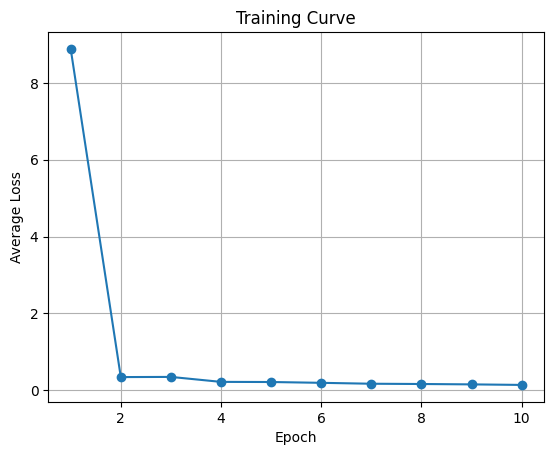

In [58]:
plt.plot(range(1, 11), losses_per_epoch, marker='o')
plt.xlabel('Epoch')
plt.ylabel('Average Loss')
plt.title('Training Curve')
plt.grid(True)
plt.show()

In [59]:
import matplotlib.pyplot as plt
import matplotlib.patches as patches
from torchvision.transforms.functional import to_tensor
from PIL import Image

In [68]:
def predict_and_visualize(model, image_dir, image_ids, coco, device, num_images=10):
    model.eval()
    images = coco.loadImgs(image_ids[:num_images])

    for img_info in images:
        image_path = os.path.join(image_dir, img_info['file_name'])
        image = Image.open(image_path).convert("RGB")
        image_tensor = to_tensor(image).unsqueeze(0).to(device)

        with torch.no_grad():
            output = model(image_tensor)
        output = [{k: v.to('cpu') for k, v in t.items()} for t in output]

        plt.figure(figsize=(10, 10))
        plt.imshow(image)
        ax = plt.gca()


        for idx, box in enumerate(output[0]['boxes']):
            score = output[0]['scores'][idx]
            label = output[0]['labels'][idx]
            if score > 0.55:
                x_min, y_min, x_max, y_max = box
                rect = patches.Rectangle((x_min, y_min), x_max - x_min, y_max - y_min, linewidth=2, edgecolor='r', facecolor='none')
                ax.add_patch(rect)
                label_name = coco.loadCats(label.item())[0]['name'] if coco else f'Label {label.item()}'
                plt.text(x_min, y_min, f'{label_name}: {score:.2f}', color='white', bbox=dict(facecolor='red', alpha=0.5))
        plt.axis('off')
        plt.show()

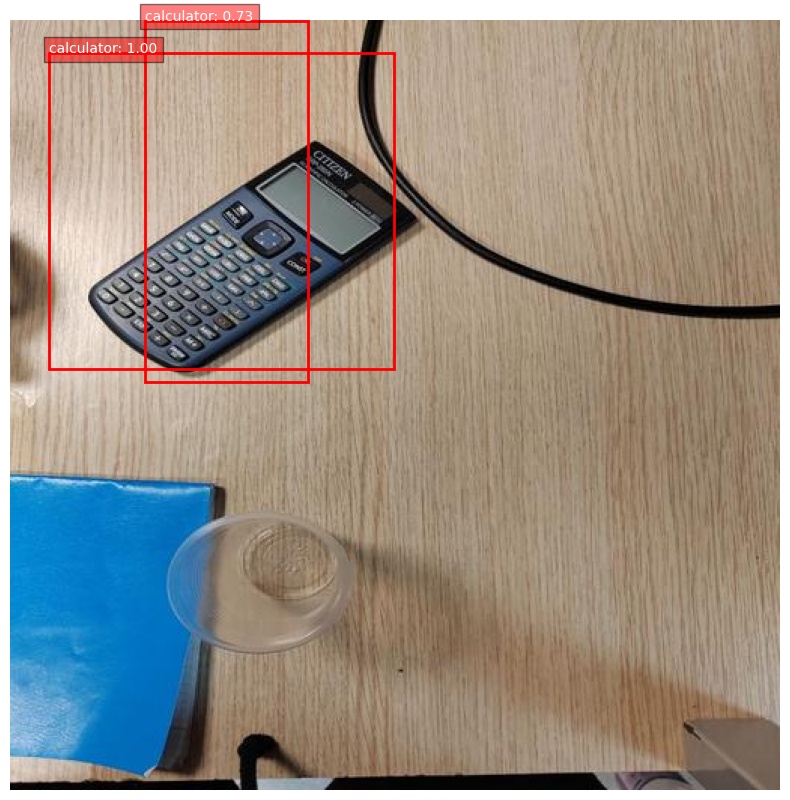

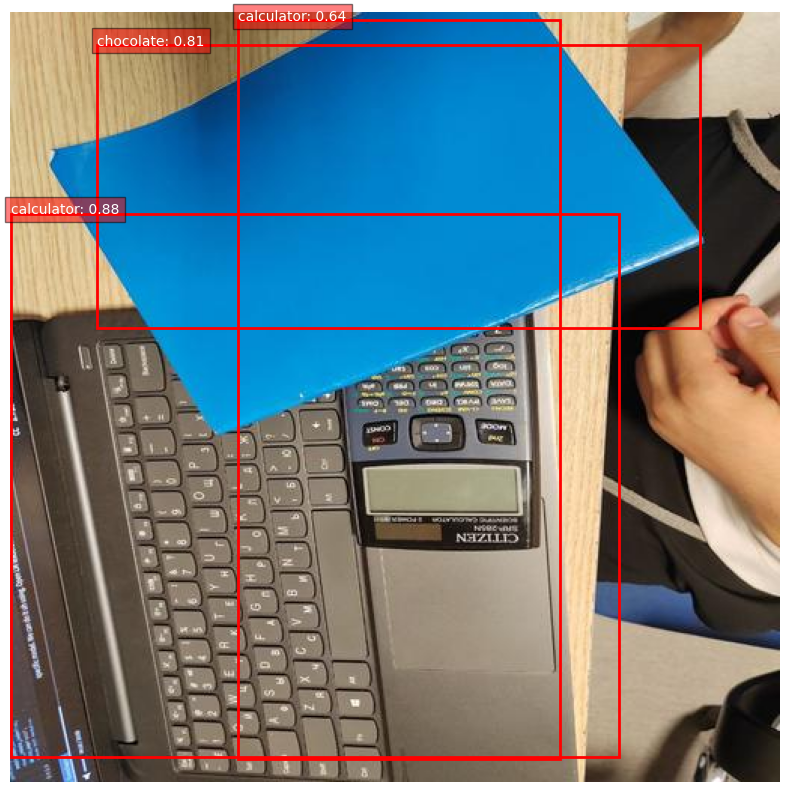

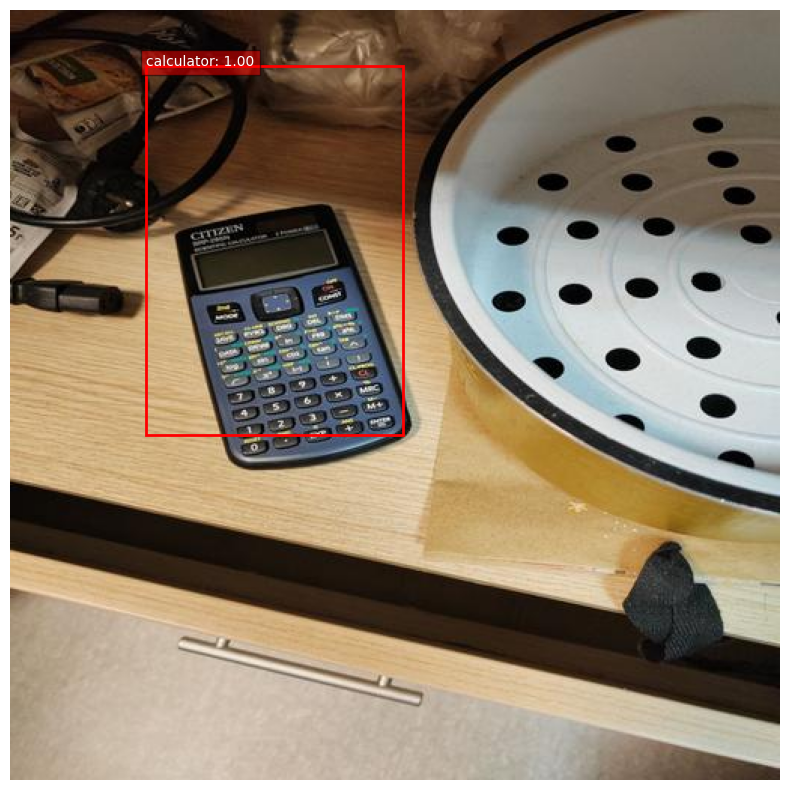

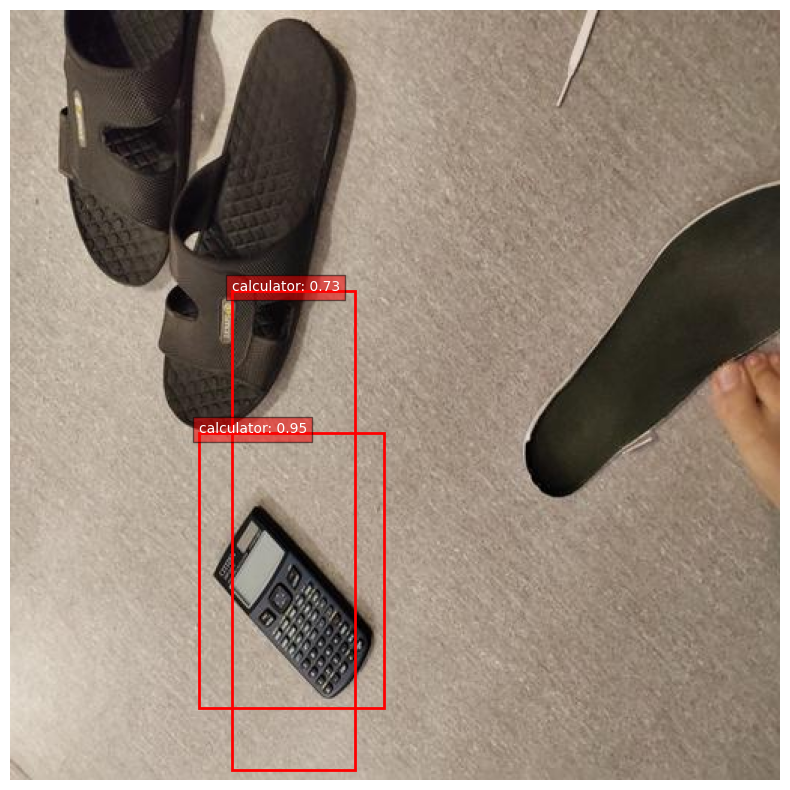

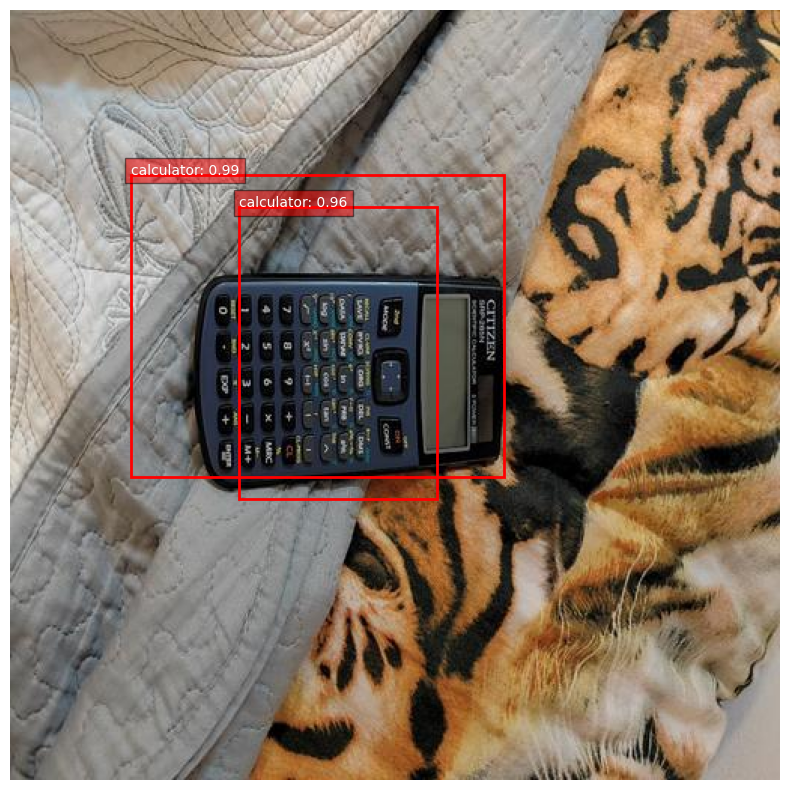

In [69]:
test_ids_calculator = [img['id'] for img in coco.loadImgs(ids=test_ids_calculator)]  # Get image IDs for calculator
predict_and_visualize(model, calculator_image_dir, test_ids_calculator, coco, device, num_images=5)

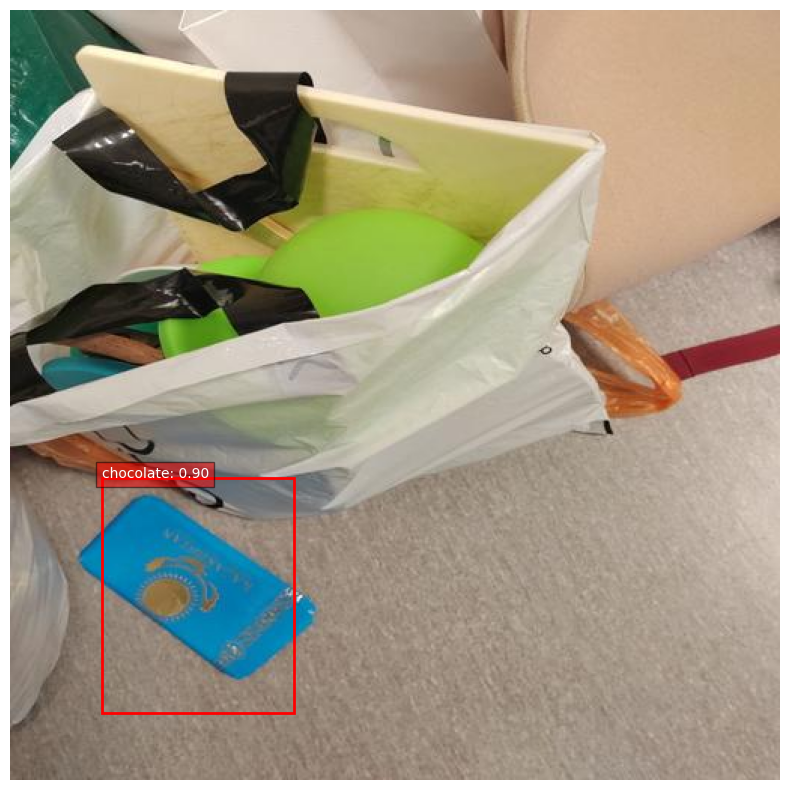

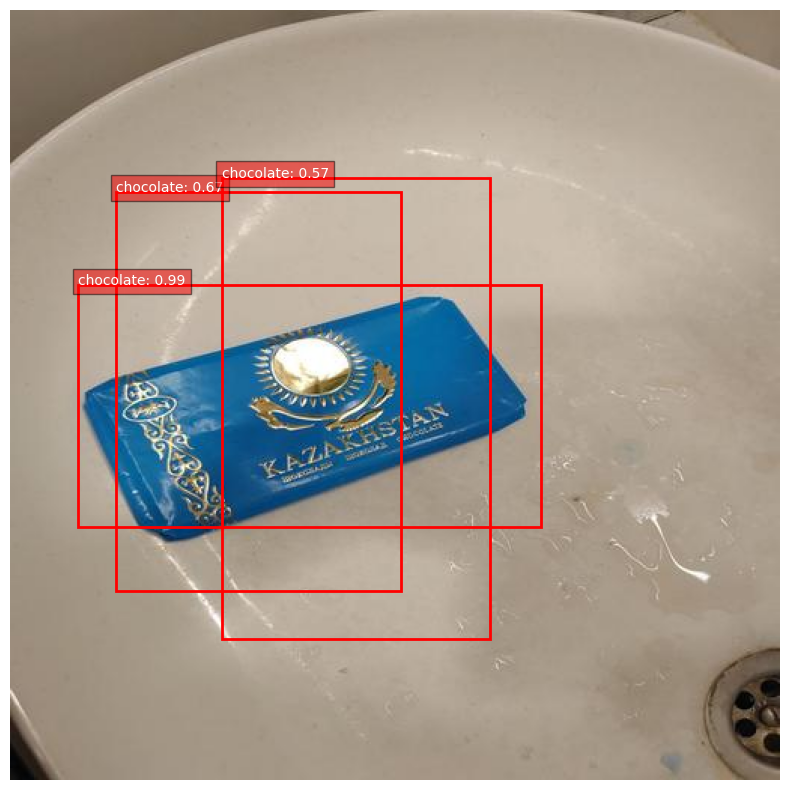

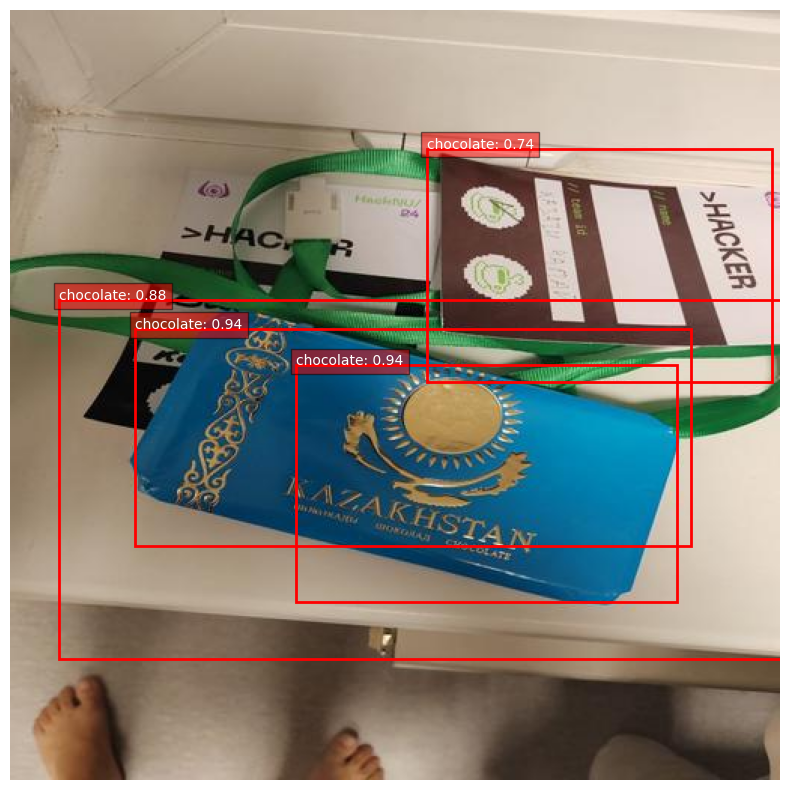

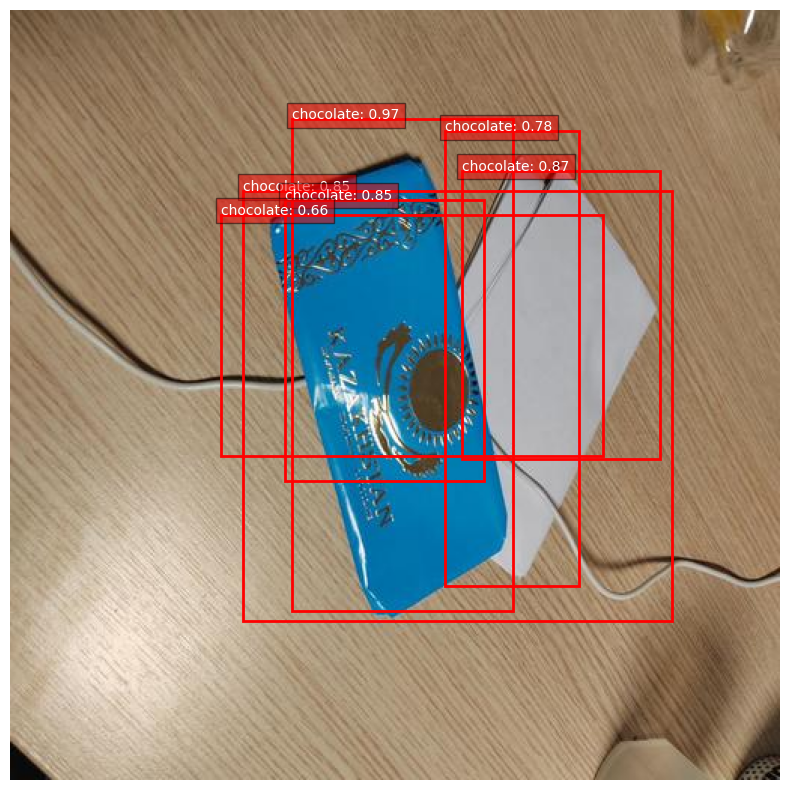

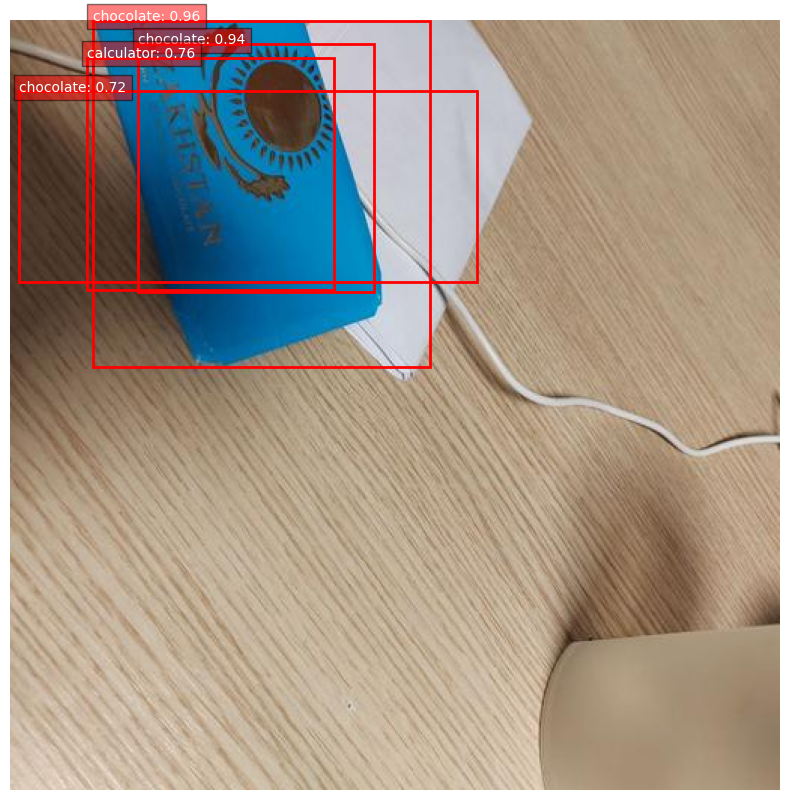

In [70]:
test_ids_chocolate = [img['id'] for img in coco.loadImgs(ids=test_ids_chocolate)]  # Get image IDs for calculator
predict_and_visualize(model, chocolate_image_dir, test_ids_chocolate, coco, device, num_images=5)